<a href="https://colab.research.google.com/github/mikekane007/Lung-Cancer-Analysis/blob/main/Lung_cancer_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
!pip install ydata-profiling
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
from ydata_profiling import ProfileReport # Now this import should work

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.5/359.5 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 10.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 21.9 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=dcce42c1ca771764af7e01984c7f33ba625b52c8db3f94765c88370e1537d2d8
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [4]:
data = pd.read_csv("lung_cancer_data.csv")
data

,Patient_ID,Age,Gender,Smoking_History,Tumor_Size_mm,Tumor_Location,Stage,Treatment,Survival_Months,Ethnicity,...,Alanine_Aminotransferase_Level,Aspartate_Aminotransferase_Level,Creatinine_Level,LDH_Level,Calcium_Level,Phosphorus_Level,Glucose_Level,Potassium_Level,Sodium_Level,Smoking_Pack_Years
0,Patient0000,68,Male,Current Smoker,81.678677,Lower Lobe,Stage III,Surgery,44,Hispanic,...,27.985571,46.801214,1.245849,239.240255,10.366307,3.547734,113.919243,4.968163,139.822861,17.006956
1,Patient0001,58,Male,Never Smoked,78.448272,Lower Lobe,Stage I,Radiation Therapy,101,Caucasian,...,30.120956,39.711531,1.463231,233.515237,10.081731,2.945020,101.321578,3.896795,135.449361,93.270893
2,Patient0002,44,Male,Former Smoker,67.714305,Lower Lobe,Stage I,Chemotherapy,69,African American,...,5.882418,32.640602,0.630109,169.037460,8.660892,4.637399,78.214177,4.369050,143.377155,70.348376
3,Patient0003,72,Male,Current Smoker,70.806008,Lower Lobe,Stage III,Chemotherapy,95,African American,...,38.908154,44.319393,0.594342,213.967590,8.832669,3.617098,127.895361,4.348474,138.586005,19.828128
4,Patient0004,37,Female,Never Smoked,87.272433,Lower Lobe,Stage IV,Radiation Therapy,105,Asian,...,26.344877,15.746906,1.478239,118.187543,9.247609,4.773255,148.801185,3.671976,141.230724,81.047456
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23653,Patient23653,45,Male,Former Smoker,91.279410,Middle Lobe,Stage I,Chemotherapy,16,Caucasian,...,21.218709,37.642878,1.469665,203.209056,9.011784,3.083901,121.588210,3.874261,138.004367,8.877173
23654,Patient23654,31,Male,Current Smoker,45.139048,Upper Lobe,Stage IV,Radiation Therapy,81,Asian,...,6.439687,45.747460,1.432533,245.095566,10.192073,4.571803,129.748104,4.635774,137.883562,33.573249
23655,Patient23655,74,Male,Former Smoker,89.640323,Upper Lobe,Stage IV,Chemotherapy,52,Asian,...,6.974531,20.982553,0.855960,214.793918,9.617543,4.877552,129.414306,3.730363,138.813953,26.893648
23656,Patient23656,47,Female,Former Smoker,45.770358,Middle Lobe,Stage I,Radiation Therapy,26,African American,...,21.817365,43.457246,0.824516,138.947588,8.239170,2.885529,127.647028,3.799932,139.706111,26.387602


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23658 entries, 0 to 23657
Data columns (total 38 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Patient_ID                        23658 non-null  object 
 1   Age                               23658 non-null  int64  
 2   Gender                            23658 non-null  object 
 3   Smoking_History                   23658 non-null  object 
 4   Tumor_Size_mm                     23658 non-null  float64
 5   Tumor_Location                    23658 non-null  object 
 6   Stage                             23658 non-null  object 
 7   Treatment                         23658 non-null  object 
 8   Survival_Months                   23658 non-null  int64  
 9   Ethnicity                         23658 non-null  object 
 10  Insurance_Type                    23658 non-null  object 
 11  Family_History                    23658 non-null  object 
 12  Como

In [6]:
data.describe()

,Age,Tumor_Size_mm,Survival_Months,Performance_Status,Blood_Pressure_Systolic,Blood_Pressure_Diastolic,Blood_Pressure_Pulse,Hemoglobin_Level,White_Blood_Cell_Count,Platelet_Count,...,Alanine_Aminotransferase_Level,Aspartate_Aminotransferase_Level,Creatinine_Level,LDH_Level,Calcium_Level,Phosphorus_Level,Glucose_Level,Potassium_Level,Sodium_Level,Smoking_Pack_Years
count,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,...,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000,23658.000000
mean,54.439344,55.383736,59.863809,1.999915,134.462381,84.475780,79.585299,14.000137,6.735637,299.867482,...,22.504677,30.133226,0.999459,174.734575,9.261114,3.742771,109.895553,4.245646,140.028215,49.913594
std,14.396386,26.004354,34.246042,1.413675,26.020492,14.409826,11.546690,2.301411,1.879292,86.897568,...,10.047864,11.560915,0.287517,43.230997,0.719875,0.721708,23.109136,0.431968,2.894568,28.870940
min,30.000000,10.004279,1.000000,0.000000,90.000000,60.000000,60.000000,10.000070,3.501213,150.017892,...,5.001090,10.000860,0.500001,100.002721,8.000018,2.500069,70.000420,3.500034,135.000934,0.016800
25%,42.000000,32.972797,30.000000,1.000000,112.000000,72.000000,70.000000,11.990625,5.108723,224.884576,...,13.816180,20.065339,0.748845,137.444977,8.640877,3.120107,89.828616,3.871842,137.540078,25.026793
50%,54.000000,55.296297,60.000000,2.000000,134.000000,85.000000,80.000000,13.983383,6.729774,299.933443,...,22.547943,30.271772,1.001183,174.390634,9.259304,3.730837,109.949488,4.242236,140.002209,49.926220
75%,67.000000,78.190014,89.000000,3.000000,157.000000,97.000000,90.000000,15.999260,8.353701,375.437029,...,31.092935,40.107488,1.249173,212.228273,9.883248,4.364422,130.061977,4.618318,142.541883,74.924580
max,79.000000,99.990554,119.000000,4.000000,179.000000,109.000000,99.000000,17.999957,9.999535,449.974734,...,39.999543,49.998571,1.499998,249.996391,10.499913,4.999974,149.997056,4.999954,144.999869,99.999493


In [7]:
data.columns.tolist()

['Patient_ID',
 'Age',
 'Gender',
 'Smoking_History',
 'Tumor_Size_mm',
 'Tumor_Location',
 'Stage',
 'Treatment',
 'Survival_Months',
 'Ethnicity',
 'Insurance_Type',
 'Family_History',
 'Comorbidity_Diabetes',
 'Comorbidity_Hypertension',
 'Comorbidity_Heart_Disease',
 'Comorbidity_Chronic_Lung_Disease',
 'Comorbidity_Kidney_Disease',
 'Comorbidity_Autoimmune_Disease',
 'Comorbidity_Other',
 'Performance_Status',
 'Blood_Pressure_Systolic',
 'Blood_Pressure_Diastolic',
 'Blood_Pressure_Pulse',
 'Hemoglobin_Level',
 'White_Blood_Cell_Count',
 'Platelet_Count',
 'Albumin_Level',
 'Alkaline_Phosphatase_Level',
 'Alanine_Aminotransferase_Level',
 'Aspartate_Aminotransferase_Level',
 'Creatinine_Level',
 'LDH_Level',
 'Calcium_Level',
 'Phosphorus_Level',
 'Glucose_Level',
 'Potassium_Level',
 'Sodium_Level',
 'Smoking_Pack_Years']

In [8]:
data.isnull().sum()

Patient_ID                          0
Age                                 0
Gender                              0
Smoking_History                     0
Tumor_Size_mm                       0
Tumor_Location                      0
Stage                               0
Treatment                           0
Survival_Months                     0
Ethnicity                           0
Insurance_Type                      0
Family_History                      0
Comorbidity_Diabetes                0
Comorbidity_Hypertension            0
Comorbidity_Heart_Disease           0
Comorbidity_Chronic_Lung_Disease    0
Comorbidity_Kidney_Disease          0
Comorbidity_Autoimmune_Disease      0
Comorbidity_Other                   0
Performance_Status                  0
Blood_Pressure_Systolic             0
Blood_Pressure_Diastolic            0
Blood_Pressure_Pulse                0
Hemoglobin_Level                    0
White_Blood_Cell_Count              0
Platelet_Count                      0
Albumin_Leve

In [9]:
data.duplicated().sum()

0

<Axes: >

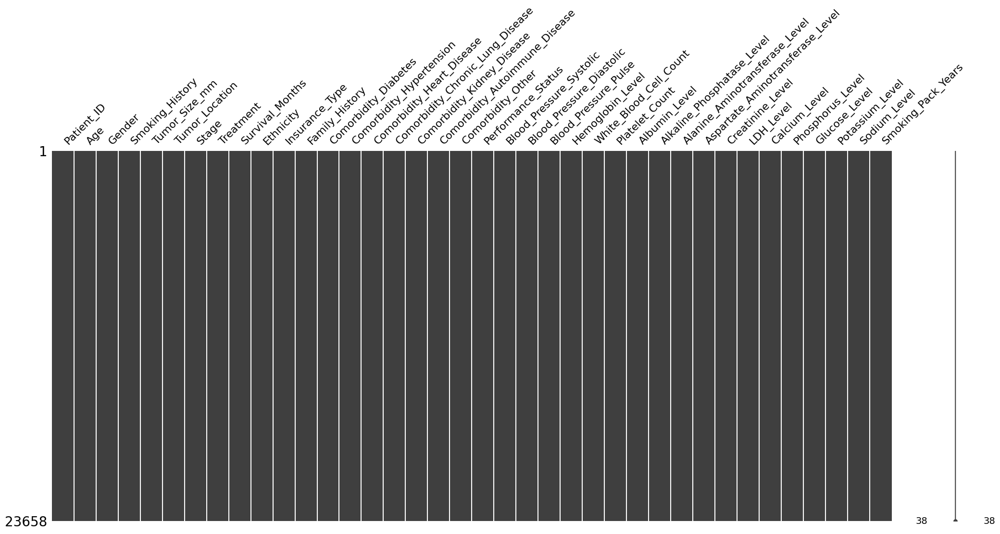

In [10]:
msno.matrix(data)

In [11]:
profile = ProfileReport(data, title='Pandas Profile Report')
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Univariate Analysis

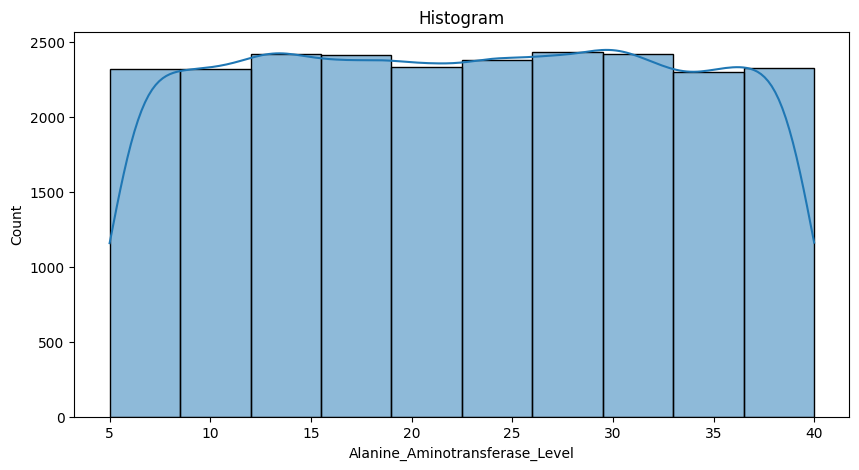

In [12]:
plt.figure(figsize=(10, 5))
sns.histplot(data['Alanine_Aminotransferase_Level'], bins=10, kde=True)
plt.title('Histogram')
plt.show()

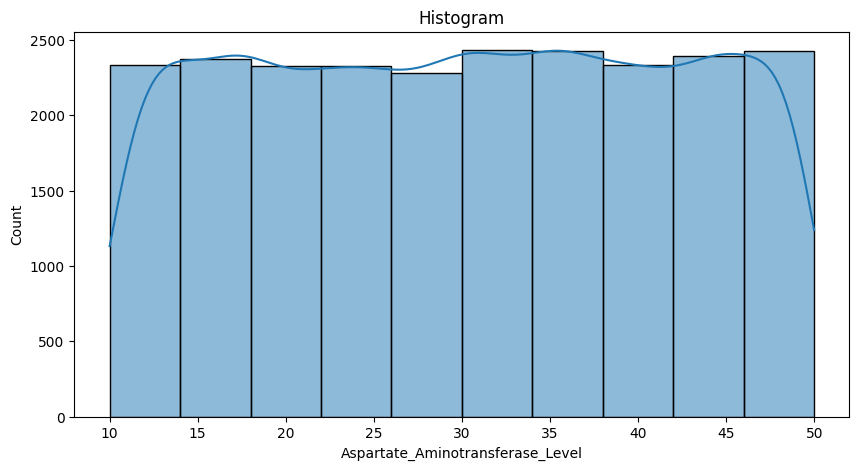

In [13]:
plt.figure(figsize=(10, 5))
sns.histplot(data['Aspartate_Aminotransferase_Level'], bins=10, kde=True)
plt.title('Histogram')
plt.show()

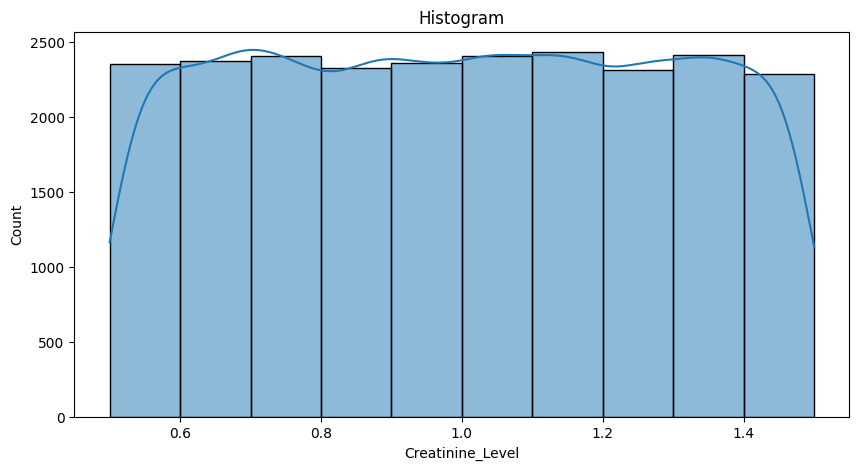

In [14]:
plt.figure(figsize=(10, 5))
sns.histplot(data['Creatinine_Level'], bins=10, kde=True)
plt.title('Histogram')
plt.show()

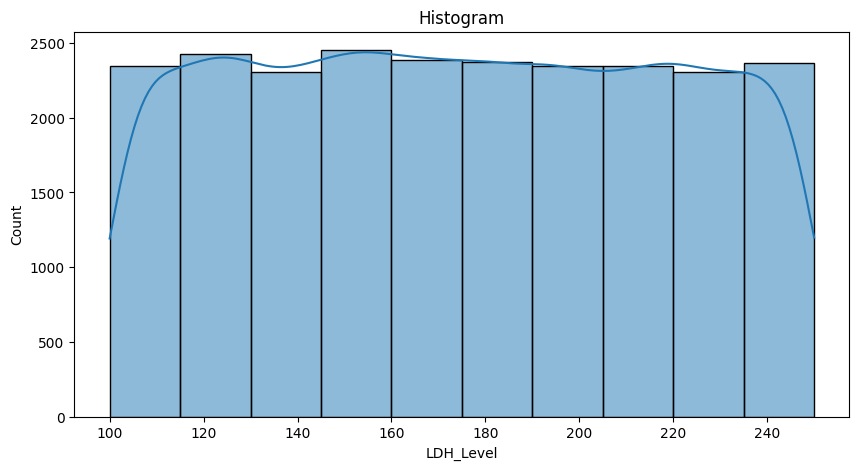

In [15]:
plt.figure(figsize=(10, 5))
sns.histplot(data['LDH_Level'], bins=10, kde=True)
plt.title('Histogram')
plt.show()

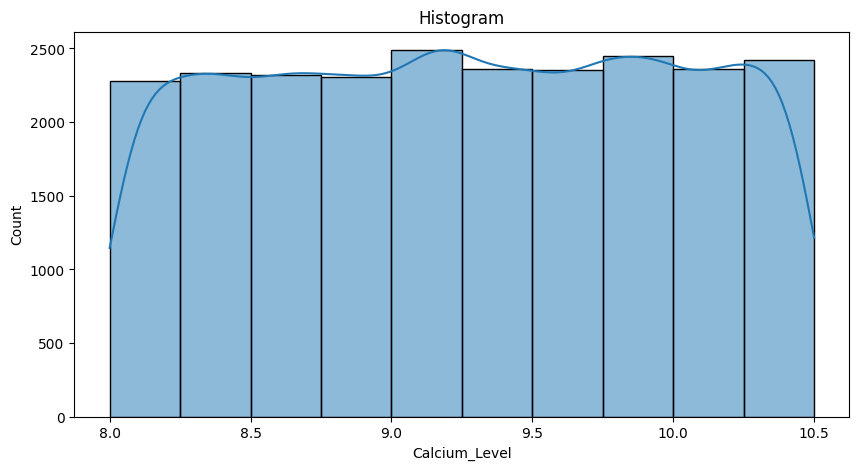

In [16]:
plt.figure(figsize=(10, 5))
sns.histplot(data['Calcium_Level'], bins=10, kde=True)
plt.title('Histogram')
plt.show()

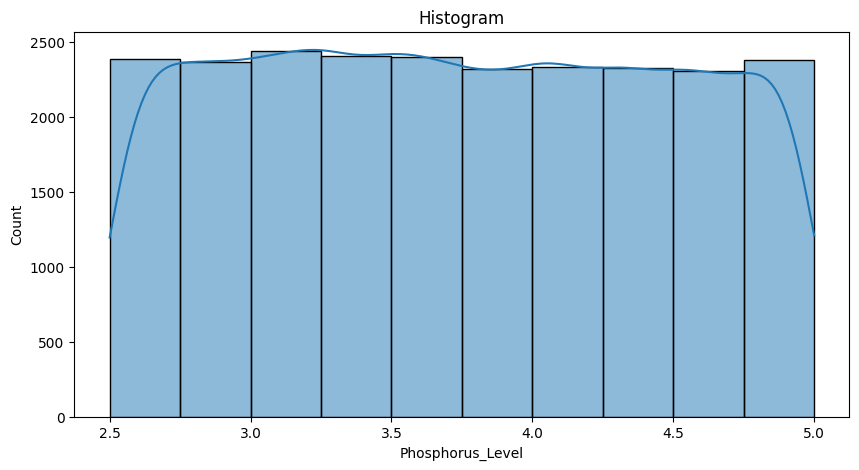

In [17]:
plt.figure(figsize=(10, 5))
sns.histplot(data['Phosphorus_Level'], bins=10, kde=True)
plt.title('Histogram')
plt.show()

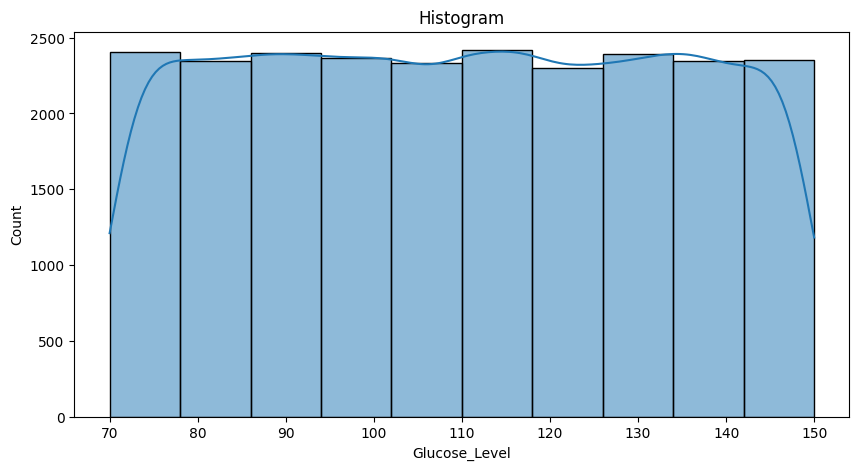

In [18]:
plt.figure(figsize=(10, 5))
sns.histplot(data['Glucose_Level'], bins=10, kde=True)
plt.title('Histogram')
plt.show()

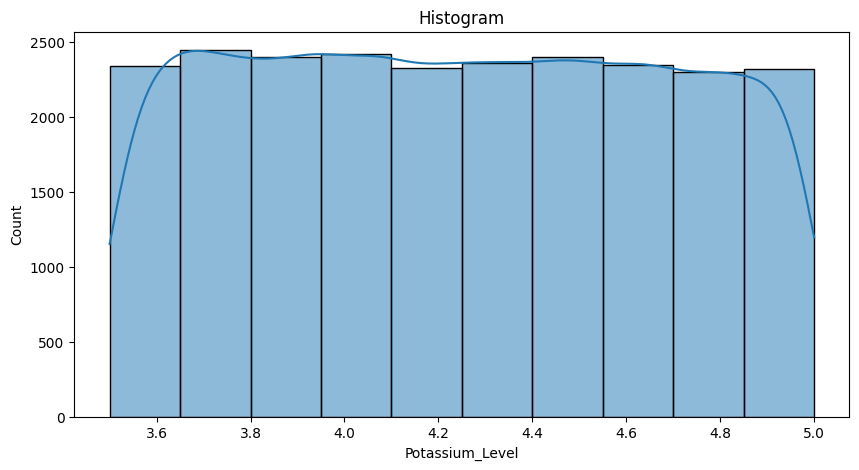

In [19]:
plt.figure(figsize=(10, 5))
sns.histplot(data['Potassium_Level'], bins=10, kde=True)
plt.title('Histogram')
plt.show()

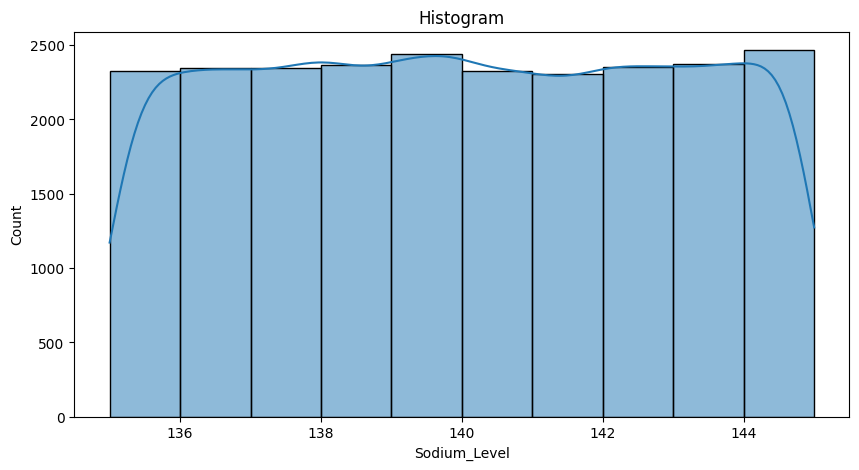

In [20]:
plt.figure(figsize=(10, 5))
sns.histplot(data['Sodium_Level'], bins=10, kde=True)
plt.title('Histogram')
plt.show()